<a href="https://colab.research.google.com/github/ns-m/data_analysis/blob/main/Product_Gallery_vizual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install lux-api #после выполнения перезапутить среду

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df = pd.read_excel('/content/drive/MyDrive/Product Gallery.xlsx', parse_dates=['OrderDate'])

In [ ]:
#df.to_excel('Product Gallery.xlsx')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2172 entries, 0 to 2171
Data columns (total 31 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Address               2172 non-null   object        
 1   CategoryID            2172 non-null   int64         
 2   Category              2172 non-null   object        
 3   City                  2172 non-null   object        
 4   Customer Company      2172 non-null   object        
 5   Shippers Company      2172 non-null   object        
 6   Customer              2172 non-null   object        
 7   Country               2172 non-null   object        
 8   EmployeeID            2172 non-null   int64         
 9   Fax                   1619 non-null   object        
 10  OrderDate             2172 non-null   datetime64[ns]
 11  OrderID               2172 non-null   int64         
 12  Phone                 2172 non-null   object        
 13  PostalCode        

In [ ]:
df['Year'] = df['OrderDate'].dt.year
df['Month'] = df['OrderDate'].dt.month
df['Day'] = df['OrderDate'].dt.day

In [ ]:
df.head()

,Address,CategoryID,Category,City,Customer Company,Shippers Company,Customer,Country,EmployeeID,Fax,...,UnitPrice,UnitPrice (Products),UnitsInStock,UnitsOnOrder,Sales,Profit,City and Counry,Year,Month,Day
0,Berliner Platz 43,2,Овощи,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Австрия,8,089-0877451,...,12.03,11.80,14,0,300.75,76.75,"Мюнхен, Австрия",2003,11,20
1,Berliner Platz 43,3,Кондитерские изделия,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Англия,8,089-0877451,...,33.55,31.23,15,0,805.20,178.08,"Мюнхен, Англия",2003,11,20
2,Berliner Platz 43,5,Мясо/Птица,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Аргентина,8,089-0877451,...,9.00,9.00,61,0,360.00,62.80,"Мюнхен, Аргентина",2003,11,20
3,Berliner Platz 43,8,Приправы,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Бельгия,8,089-0877451,...,7.99,8.00,112,0,159.80,30.80,"Мюнхен, Бельгия",2003,11,20
4,Berliner Platz 43,8,Приправы,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Бразилия,8,089-0877451,...,3.90,4.00,11,50,109.20,13.16,"Мюнхен, Бразилия",2003,11,20


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2172 entries, 0 to 2171
Data columns (total 34 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Address               2172 non-null   object        
 1   CategoryID            2172 non-null   int64         
 2   Category              2172 non-null   object        
 3   City                  2172 non-null   object        
 4   Customer Company      2172 non-null   object        
 5   Shippers Company      2172 non-null   object        
 6   Customer              2172 non-null   object        
 7   Country               2172 non-null   object        
 8   EmployeeID            2172 non-null   int64         
 9   Fax                   1619 non-null   object        
 10  OrderDate             2172 non-null   datetime64[ns]
 11  OrderID               2172 non-null   int64         
 12  Phone                 2172 non-null   object        
 13  PostalCode        

In [ ]:
df_Овощи = df[df['Category'] == 'Овощи']
df_Овощи

,Address,CategoryID,Category,City,Customer Company,Shippers Company,Customer,Country,EmployeeID,Fax,...,UnitPrice,UnitPrice (Products),UnitsInStock,UnitsOnOrder,Sales,Profit,City and Counry,Year,Month,Day
0,Berliner Platz 43,2,Овощи,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Австрия,8,089-0877451,...,12.03,11.80,14,0,300.75,76.75,"Мюнхен, Австрия",2003,11,20
21,5? Ave. Los Palos Grandes,2,Овощи,Каракас,Венесуэльские продукты,ТрансАвтоГруз,Antonio Palmer Amer,Венесуэла,3,(2) 283-3397,...,12.64,11.80,14,0,50.56,14.72,"Каракас, Венесуэла",2004,2,25
23,Berguvsv?gen 8,2,Овощи,Лулеа,Магазин для всей семьи,ТрансАвтоГруз,Urra Gurra Aktersnurra,Швеция,2,0921-12 34 67,...,21.02,19.90,24,0,168.16,40.96,"Лулеа, Швеция",2004,3,9
24,Berguvsv?gen 8,2,Овощи,Лулеа,Магазин для всей семьи,ТрансАвтоГруз,Urra Gurra Aktersnurra,Швеция,2,0921-12 34 67,...,80.78,75.45,27,0,1292.48,217.76,"Лулеа, Швеция",2004,3,9
27,"Rua da Panificadora, 12",2,Овощи,Рио де Жанейро,Копакобана,ТрансАвтоГруз,Giovanni Santhos,Бразилия,2,(21) 555-4545,...,82.68,75.45,27,0,1984.32,372.24,"Рио де Жанейро, Бразилия",2004,3,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2142,Via Ludovico il Moro 22,2,Овощи,Бергамо,Караван,ТрансСервис,Luca Brassi,Италия,6,035-640231,...,22.86,22.00,53,0,114.30,17.60,"Бергамо, Италия",2007,7,14
2146,8 Johnstown Road,2,Овощи,Корк,Волынка,ТрансАвтоГруз,Robert Bolero,Ирландия,9,########,...,60.96,60.80,0,0,1219.20,171.60,"Корк, Ирландия",2007,7,15
2149,"25, rue Lauriston",2,Овощи,Париж,Замок Вилль,ТрансСервис,Andr? Millard,Франция,4,(1) 47.55.60.20,...,87.28,80.50,17,0,436.40,124.50,"Париж, Франция",2007,7,18
2164,"2, rue du Commerce",2,Овощи,Лион,Фуд Шоп,ТрансСервис,Pierre Robert,Франция,4,78.32.54.87,...,9.47,10.05,76,0,18.94,1.58,"Лион, Франция",2007,7,29


In [ ]:
g = df_Овощи[['OrderDate', 'Sales', 'Profit', 'Quantity']]
g.head()

,OrderDate,Sales,Profit,Quantity
0,2003-11-20,300.75,76.75,25
21,2004-02-25,50.56,14.72,4
23,2004-03-09,168.16,40.96,8
24,2004-03-09,1292.48,217.76,16
27,2004-03-24,1984.32,372.24,24


<Axes: xlabel='OrderDate'>

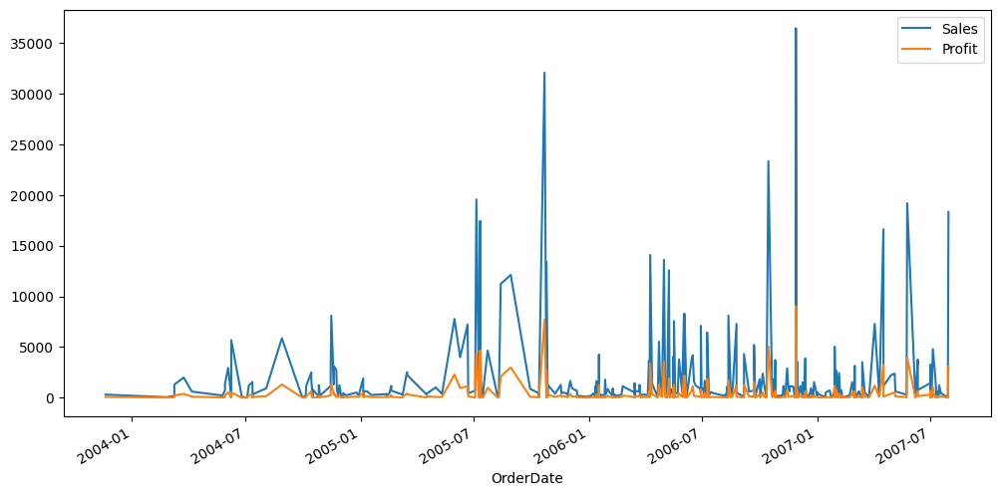

In [ ]:
g.plot(x='OrderDate', y=['Sales', 'Profit'], figsize = (12,6))

In [ ]:
#from matplotlib import rcParams

# figure size in inches
#rcParams['figure.figsize'] = 6,12

<ipython-input-12-a0a72d76947b>:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.relplot(


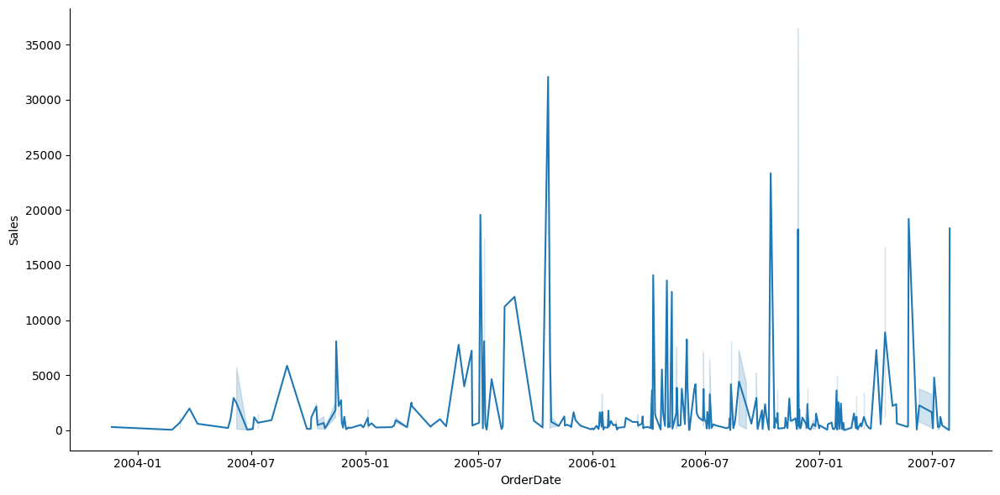

In [ ]:
# Define the palette as a list to specify exact values
palette = sns.color_palette("rocket_r")


sns.relplot(
    data=g,
    x="OrderDate", y='Sales',
    #hue="coherence", size="choice", col="align",
    kind="line", 
    #size_order=["T1", "T2"], 
    palette=palette,
    height=6, aspect=12/6, facet_kws=dict(sharex=False),
)

In [ ]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27

NameError: ignored

<Axes: xlabel='OrderDate', ylabel='Sales'>

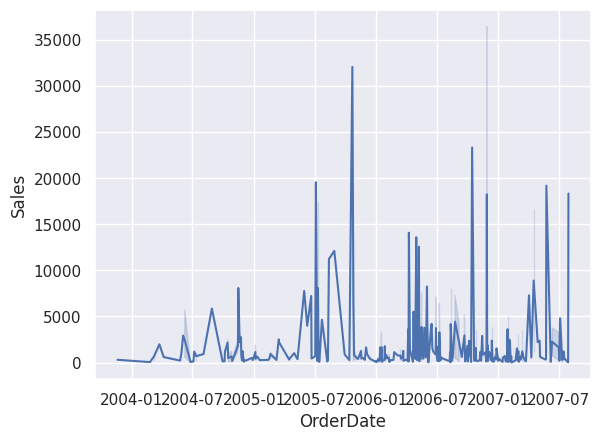

In [ ]:
sns.set_theme(style="darkgrid")
sns.lineplot( x="OrderDate",  y="Sales",          
             data=g)

<Axes: >

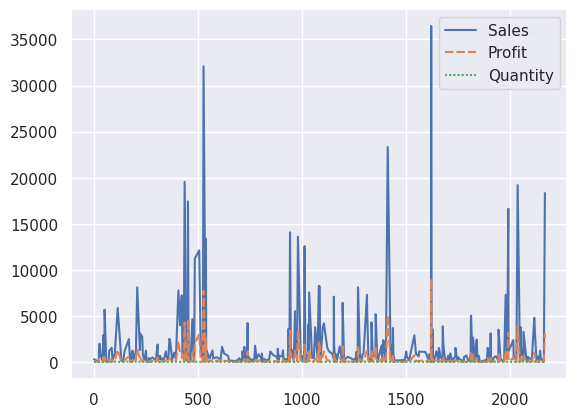

In [ ]:
sns.set_theme(style="darkgrid")
sns.lineplot(          
             data=g)

<Axes: ylabel='Frequency'>

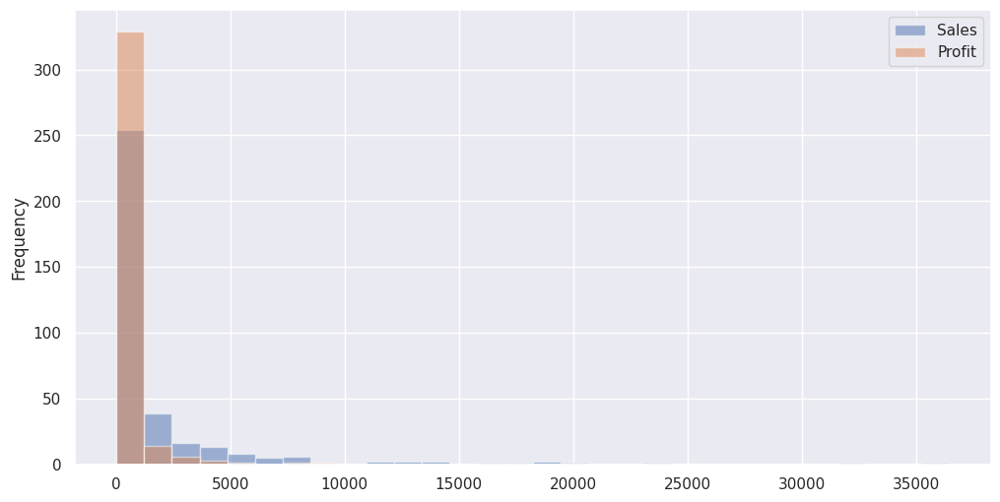

In [ ]:
h = df_Овощи[['Sales', 'Profit']]
h.plot.hist(alpha=0.5, bins =30, figsize = (12,6))

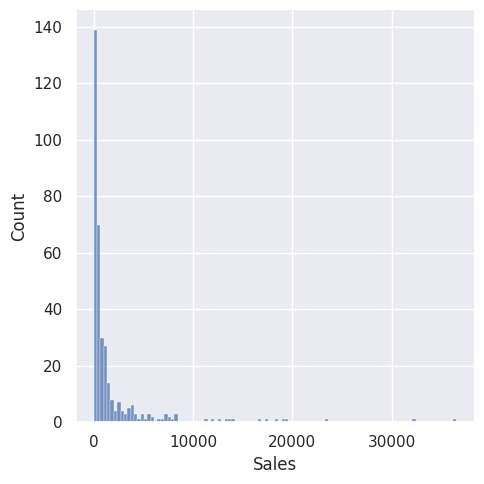

In [ ]:
sns.displot(
    h, x="Sales", 
    #col="species", row="sex",
    #binwidth=3, height=3, facet_kws=dict(margin_titles=True),
)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f37099bc670>,
      dtype=object)

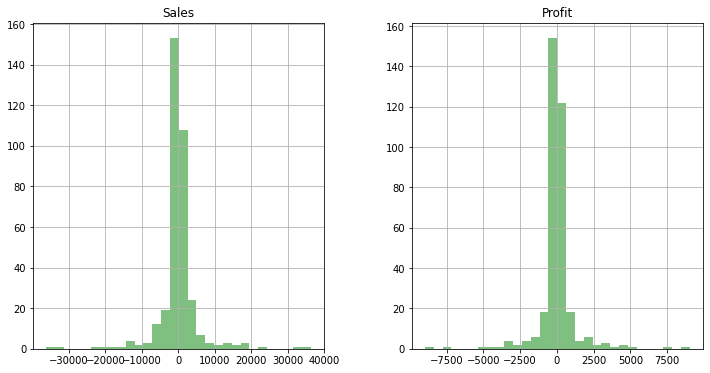

In [ ]:
h.diff().hist(color = 'g', alpha=0.5, bins =30, figsize = (12,6))

In [ ]:
import plotly.express as px
fig = px.scatter(df, x="Sales", y="Profit", color="Category")
fig.show()

In [ ]:
px.histogram(df, x="Sales", nbins=100)


In [ ]:
fig = px.funnel(df, y="Category", x="Quantity") #, color= 'Category')
fig.show()

In [ ]:
f = df.query('Country in ["Германия", "Франиция"]')
f = f.query('Year == 2007')
fig = px.line(f, x="OrderDate", y=["Sales", "Profit"])#, color="City")#, title='Life expectancy in Canada')
fig.show()

In [ ]:
fig = px.scatter(df, x="Quantity", y="Sales", trendline="ols")
fig.show()

In [ ]:
px.scatter(df_Овощи, x='Sales',y='Profit',size='Quantity',hover_name="Product",
           size_max=40, color='Country',facet_col='Category', log_x=True)

In [ ]:
px.scatter(df, x='Sales',y='Profit',size='Quantity',hover_name="Product",
           size_max=20, color='Country',facet_col='Category', log_x=True)

In [ ]:
px.scatter(df, x='Sales',y='Profit',size='Quantity',hover_name="Product",
           size_max=30, color='Country',facet_col='Year', log_x=True)

In [ ]:
px.scatter(df, x='Sales',y='Profit',size='Quantity',hover_name="Product",
           size_max=20, color='Country',animation_frame="Year", animation_group='Product')

In [ ]:
df_2006 = df.query("Year == 2006")

In [ ]:
px.histogram(df_2006, x="Sales", y="Profit", histfunc="sum", color="Category")

In [ ]:
px.box(df, x="Sales", y="Category", orientation="h", notched=True, hover_name="Product")

In [ ]:
px.box(df, x="Quantity", y="Year", orientation="h",)#color='Category')

In [ ]:
px.box(df, y="Profit", x="Category", orientation="v", 
       
       )

In [ ]:
px.scatter(df, x="Sales", y="Profit", color="Category",trendline="ols", marginal_x="violin", marginal_y="box")

# **Altair**

In [ ]:
import altair as alt
interval = alt.selection_interval()

points = alt.Chart(df).mark_point().encode(
  y='Sales',
  x='Quantity',
  color=alt.condition(interval, 'Category', alt.value('lightgray'))
).properties(
  selection=interval
)

bar = alt.Chart(df).mark_bar().encode(
  x='sum(Sales)',
  y='Category',
  color='Category'
).transform_filter(interval)

points & bar

alt.VConcatChart(...)

In [ ]:
import altair as alt
alt.Chart(df).mark_line().encode(
  x='OrderDate:T',
  y='Sales',
  color='Category'
).properties(width =800).interactive(bind_y=True)

alt.Chart(...)

In [ ]:
alt.Chart(df).mark_area().encode(
    alt.X('yearmonth(OrderDate):T',
        axis=alt.Axis(format='%Y', domain=False, tickSize=0)
    ),
    alt.Y('sum(Profit):Q', stack='center', axis=None),
    alt.Color('Category:N',
#        scale=alt.Scale(scheme='category20b')
    )
).properties(width =800).interactive()

alt.Chart(...)

# **Lux**

In [ ]:
import altair as alt
import lux

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
df['Year'] = df['OrderDate'].dt.year
df['Month'] = df['OrderDate'].dt.month
df['Day'] = df['OrderDate'].dt.day

In [ ]:
df

,Address,CategoryID,Category,City,Customer Company,Shippers Company,Customer,Country,EmployeeID,Fax,...,UnitPrice,UnitPrice (Products),UnitsInStock,UnitsOnOrder,Sales,Profit,City and Counry,Year,Month,Day
0,Berliner Platz 43,2,Овощи,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Австрия,8,089-0877451,...,12.03,11.80,14,0,300.75,76.75,"Мюнхен, Австрия",2003,11,20
1,Berliner Platz 43,3,Кондитерские изделия,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Англия,8,089-0877451,...,33.55,31.23,15,0,805.20,178.08,"Мюнхен, Англия",2003,11,20
2,Berliner Platz 43,5,Мясо/Птица,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Аргентина,8,089-0877451,...,9.00,9.00,61,0,360.00,62.80,"Мюнхен, Аргентина",2003,11,20
3,Berliner Platz 43,8,Приправы,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Бельгия,8,089-0877451,...,7.99,8.00,112,0,159.80,30.80,"Мюнхен, Бельгия",2003,11,20
4,Berliner Platz 43,8,Приправы,Мюнхен,Мюнхенские традиции,ТрансАвтоГруз,Dieter K?ln,Бразилия,8,089-0877451,...,3.90,4.00,11,50,109.20,13.16,"Мюнхен, Бразилия",2003,11,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2167,1900 Oak St.,3,Кондитерские изделия,Ванкувер,Милелниум,АвтоЛогистика,Joe Barry,Канада,1,(604) 555-7293,...,13.43,14.00,76,0,67.15,12.90,"Ванкувер, Канада",2007,7,30
2168,1900 Oak St.,8,Приправы,Ванкувер,Милелниум,АвтоЛогистика,Joe Barry,Канада,1,(604) 555-7293,...,24.76,25.00,24,0,173.32,25.55,"Ванкувер, Канада",2007,7,30
2169,35 King George,2,Овощи,Лондон,Продуктовый магазин,ТрансАвтоГруз,Greg Thatcher,Англия,3,(171) 555-3373,...,366.56,399.00,57,0,18328.00,3093.00,"Лондон, Англия",2007,7,30
2170,35 King George,5,Мясо/Птица,Лондон,Продуктовый магазин,ТрансАвтоГруз,Greg Thatcher,Англия,3,(171) 555-3373,...,38.88,38.00,21,10,777.60,94.20,"Лондон, Англия",2007,7,30


In [ ]:
vis = df.exported[0]
vis

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
vis = df.exported[1]
vis

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
df.intent = ["Sales", "Year"]
df

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:257: UserWarning:
Lux detects that the attribute 'PostalCode' maybe contain mixed type.
To visualize this attribute, you may want to convert the 'PostalCode' into a uniform type as follows:
	df['PostalCode'] = df['PostalCode'].astype(str)


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
vis = df.exported[0]
vis

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
df_Овощи_500 = df[(df["Sales"]>500) & (df["Category"]=="Овощи")]
df_Овощи_500

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:448: UserWarning:
Lux detects that attributes ['Year', 'Month', 'Day'] may be temporal.
To display visualizations for these attributes accurately, please convert temporal attributes to Datetime objects.
For example, you can convert a Year attribute (e.g., 1998, 1971, 1982) using pd.to_datetime by specifying the `format` as '%Y'.

Here is a starter template that you can use for converting the temporal fields:
	df['Year'] = pd.to_datetime(df['Year'], format='<replace-with-datetime-format>')
	df['Month'] = pd.to_datetime(df['Month'], format='<replace-with-datetime-format>')
	df['Day'] = pd.to_datetime(df['Day'], format='<replace-with-datetime-format>')

See more at: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.to_datetime.html
If Day is not a temporal attribute, please use override Lux's automatically detected type:
	df.set_data_type({'Day':'quantitative'})
/usr/local/lib/python3.8/dist-packages/lux

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
df_Овощи_500.intent = ["Sales", "Month"]
df_Овощи_500

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:257: UserWarning:
Lux detects that the attribute 'PostalCode' maybe contain mixed type.
To visualize this attribute, you may want to convert the 'PostalCode' into a uniform type as follows:
	df['PostalCode'] = df['PostalCode'].astype(str)


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
vis = df.exported[0]
vis

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
print(vis.to_altair())

df
def plot_barchart(source_df, vis):
	import altair as alt
	visData = create_chart_data(source_df, vis)
	
	chart = alt.Chart(visData).mark_bar().encode(
	    x=alt.X('Sales', title='Sales (binned)',bin=alt.Bin(binned=True, step=3646.048), type='quantitative', axis=alt.Axis(labelOverlap=True, title='Sales (binned)'), scale=alt.Scale(domain=(2.12, 36462.6))),
	            x2='Sales_end',
	    y=alt.Y("Number of Records", type="quantitative")
	)
	
	chart = chart.configure_title(fontWeight=500,fontSize=13,font='Helvetica Neue')
	chart = chart.configure_axis(titleFontWeight=500,titleFontSize=11,titleFont='Helvetica Neue',
				labelFontWeight=400,labelFontSize=8,labelFont='Helvetica Neue',labelColor='#505050')
	chart = chart.configure_legend(titleFontWeight=500,titleFontSize=10,titleFont='Helvetica Neue',
				labelFontWeight=400,labelFontSize=8,labelFont='Helvetica Neue')
	chart = chart.properties(width=160,height=150)
	
	return chart
#plot_barchart(your_df, vis) this creates an Altair plot

In [ ]:
df
def plot_linechart(source_df, vis):
	import altair as alt
#	visData = create_chart_data(df, vis)
	visData = pd.DataFrame({'Month': {0: 1, 1: 2, 2: 3, 3: 4, 4: 5, 5: 6, 6: 7, 7: 8, 8: 9, 9: 10, 10: 11, 11: 12}, 'Record': {0: 223, 1: 164, 2: 179, 3: 109, 4: 160, 5: 144, 6: 270, 7: 140, 8: 77, 9: 169, 10: 296, 11: 241}})
	
	chart = alt.Chart(visData).mark_line().encode(
	    y = alt.Y('Record', type= 'quantitative', title='Number of Records', axis=alt.Axis(title='Record')),
	    x = alt.X('Month', type = 'temporal', axis=alt.Axis(title='Month')),
	)
	chart = chart.interactive() # Enable Zooming and Panning
	
	chart = chart.configure_title(fontWeight=500,fontSize=13,font='Helvetica Neue')
	chart = chart.configure_axis(titleFontWeight=500,titleFontSize=11,titleFont='Helvetica Neue',
				labelFontWeight=400,labelFontSize=8,labelFont='Helvetica Neue',labelColor='#505050')
	chart = chart.configure_legend(titleFontWeight=500,titleFontSize=10,titleFont='Helvetica Neue',
				labelFontWeight=400,labelFontSize=8,labelFont='Helvetica Neue')
	chart = chart.properties(width=600,height=200)
	
	return chart
plot_linechart(df, vis)

alt.Chart(...)

In [ ]:
from lux.vis.Vis import Vis
Vis(["Customer","Profit"],df)

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
from lux.vis.VisList import VisList

In [ ]:
VisList(["Sales","?"],df)

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:257: UserWarning:
Lux detects that the attribute 'PostalCode' maybe contain mixed type.
To visualize this attribute, you may want to convert the 'PostalCode' into a uniform type as follows:
	df['PostalCode'] = df['PostalCode'].astype(str)


LuxWidget(recommendations=[{'action': 'Vis List', 'description': 'Shows a vis list defined by the intent', 'vs…

In [ ]:
vis = df.exported
vis

LuxWidget(recommendations=[{'action': 'Vis List', 'description': 'Shows a vis list defined by the intent', 'vs…

In [ ]:
Vis(["Category",lux.Clause("Sales",aggregation="sum")],df)

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
Vis(["Product",lux.Clause("Sales",aggregation="sum")],df)

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
VisList([lux.Clause("Sales",aggregation="sum"),"?"],df)

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:257: UserWarning:
Lux detects that the attribute 'PostalCode' maybe contain mixed type.
To visualize this attribute, you may want to convert the 'PostalCode' into a uniform type as follows:
	df['PostalCode'] = df['PostalCode'].astype(str)


LuxWidget(recommendations=[{'action': 'Vis List', 'description': 'Shows a vis list defined by the intent', 'vs…

In [ ]:
df.intent = ['Sales','Category']
df

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:257: UserWarning:
Lux detects that the attribute 'PostalCode' maybe contain mixed type.
To visualize this attribute, you may want to convert the 'PostalCode' into a uniform type as follows:
	df['PostalCode'] = df['PostalCode'].astype(str)


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
vis = df.exported
vis

LuxWidget(recommendations=[{'action': 'Vis List', 'description': 'Shows a vis list defined by the intent', 'vs…

In [ ]:
vis = df.exported[0]
vis

LuxWidget(current_vis={'config': {'view': {'continuousWidth': 400, 'continuousHeight': 300}, 'axis': {'labelCo…

In [ ]:
print (vis.to_matplotlib())

import matplotlib.pyplot as plt
plt.rcParams.update(
            {
                "axes.titlesize": 20,
                "axes.titleweight": "bold",
                "axes.labelweight": "bold",
                "axes.labelsize": 16,
                "legend.fontsize": 14,
                "legend.title_fontsize": 15,
                "xtick.labelsize": 13,
                "ytick.labelsize": 13,
            }
        )
import numpy as np
from math import nan
df = pd.DataFrame({'Category': {0: 'Кондитерские изделия', 1: 'Кондитерские изделия', 2: 'Кондитерские изделия', 3: 'Кондитерские изделия', 4: 'Кондитерские изделия', 5: 'Кондитерские изделия', 6: 'Кондитерские изделия', 7: 'Кондитерские изделия', 8: 'Крупы', 9: 'Крупы', 10: 'Крупы', 11: 'Крупы', 12: 'Крупы', 13: 'Крупы', 14: 'Крупы', 15: 'Крупы', 16: 'Молочные продукты', 17: 'Молочные продукты', 18: 'Молочные продукты', 19: 'Молочные продукты', 20: 'Молочные продукты', 21: 'Молочные продукты', 22: 'Молочные продукты', 23: 'Молочные прод

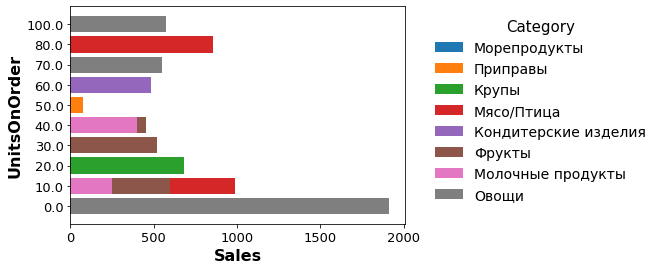

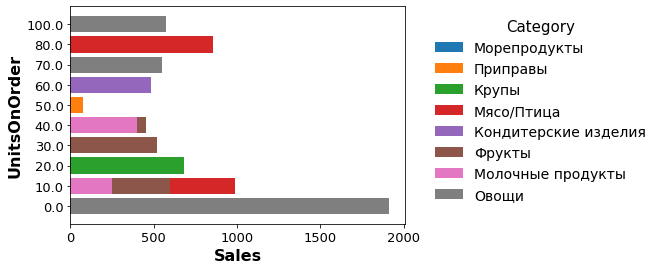

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams.update(
            {
                "axes.titlesize": 20,
                "axes.titleweight": "bold",
                "axes.labelweight": "bold",
                "axes.labelsize": 16,
                "legend.fontsize": 14,
                "legend.title_fontsize": 15,
                "xtick.labelsize": 13,
                "ytick.labelsize": 13,
            }
        )
import numpy as np
from math import nan
df = pd.DataFrame({'UnitsOnOrder': {0: 0.0, 1: 0.0, 2: 0.0, 3: 0.0, 4: 0.0, 5: 0.0, 6: 0.0, 7: 0.0, 8: 10.0, 9: 10.0, 10: 10.0, 11: 10.0, 12: 10.0, 13: 10.0, 14: 10.0, 15: 10.0, 16: 20.0, 17: 20.0, 18: 20.0, 19: 20.0, 20: 20.0, 21: 20.0, 22: 20.0, 23: 20.0, 24: 30.0, 25: 30.0, 26: 30.0, 27: 30.0, 28: 30.0, 29: 30.0, 30: 30.0, 31: 30.0, 32: 40.0, 33: 40.0, 34: 40.0, 35: 40.0, 36: 40.0, 37: 40.0, 38: 40.0, 39: 40.0, 40: 50.0, 41: 50.0, 42: 50.0, 43: 50.0, 44: 50.0, 45: 50.0, 46: 50.0, 47: 50.0, 48: 60.0, 49: 60.0, 50: 60.0, 51: 60.0, 52: 60.0, 53: 60.0, 54: 60.0, 55: 60.0, 56: 70.0, 57: 70.0, 58: 70.0, 59: 70.0, 60: 70.0, 61: 70.0, 62: 70.0, 63: 70.0, 64: 80.0, 65: 80.0, 66: 80.0, 67: 80.0, 68: 80.0, 69: 80.0, 70: 80.0, 71: 80.0, 72: 100.0, 73: 100.0, 74: 100.0, 75: 100.0, 76: 100.0, 77: 100.0, 78: 100.0, 79: 100.0}, 'Category': {0: 'Овощи', 1: 'Фрукты', 2: 'Приправы', 3: 'Молочные продукты', 4: 'Мясо/Птица', 5: 'Морепродукты', 6: 'Кондитерские изделия', 7: 'Крупы', 8: 'Крупы', 9: 'Фрукты', 10: 'Кондитерские изделия', 11: 'Приправы', 12: 'Овощи', 13: 'Морепродукты', 14: 'Молочные продукты', 15: 'Мясо/Птица', 16: 'Овощи', 17: 'Морепродукты', 18: 'Приправы', 19: 'Крупы', 20: 'Фрукты', 21: 'Мясо/Птица', 22: 'Кондитерские изделия', 23: 'Молочные продукты', 24: 'Овощи', 25: 'Фрукты', 26: 'Крупы', 27: 'Морепродукты', 28: 'Кондитерские изделия', 29: 'Приправы', 30: 'Мясо/Птица', 31: 'Молочные продукты', 32: 'Приправы', 33: 'Кондитерские изделия', 34: 'Морепродукты', 35: 'Фрукты', 36: 'Крупы', 37: 'Овощи', 38: 'Молочные продукты', 39: 'Мясо/Птица', 40: 'Крупы', 41: 'Морепродукты', 42: 'Приправы', 43: 'Кондитерские изделия', 44: 'Молочные продукты', 45: 'Мясо/Птица', 46: 'Фрукты', 47: 'Овощи', 48: 'Молочные продукты', 49: 'Крупы', 50: 'Приправы', 51: 'Кондитерские изделия', 52: 'Овощи', 53: 'Фрукты', 54: 'Мясо/Птица', 55: 'Морепродукты', 56: 'Овощи', 57: 'Приправы', 58: 'Фрукты', 59: 'Морепродукты', 60: 'Молочные продукты', 61: 'Мясо/Птица', 62: 'Крупы', 63: 'Кондитерские изделия', 64: 'Молочные продукты', 65: 'Морепродукты', 66: 'Овощи', 67: 'Кондитерские изделия', 68: 'Фрукты', 69: 'Мясо/Птица', 70: 'Крупы', 71: 'Приправы', 72: 'Кондитерские изделия', 73: 'Молочные продукты', 74: 'Фрукты', 75: 'Мясо/Птица', 76: 'Овощи', 77: 'Приправы', 78: 'Морепродукты', 79: 'Крупы'}, 'Sales': {0: 1913.1523423423423, 1: 348.1473544973545, 2: 409.2074276527331, 3: 208.8215189873418, 4: 551.3935294117647, 5: 1631.5273722627737, 6: 514.675278969957, 7: 856.8861176470589, 8: 0.0, 9: 599.1166666666667, 10: 294.6144117647059, 11: 0.0, 12: 0.0, 13: 0.0, 14: 251.33357142857145, 15: 986.4616000000001, 16: 0.0, 17: 0.0, 18: 0.0, 19: 680.4784615384615, 20: 0.0, 21: 0.0, 22: 0.0, 23: 0.0, 24: 0.0, 25: 517.186052631579, 26: 0.0, 27: 0.0, 28: 0.0, 29: 0.0, 30: 0.0, 31: 0.0, 32: 0.0, 33: 257.19875, 34: 0.0, 35: 451.2897777777778, 36: 0.0, 37: 0.0, 38: 400.95733333333334, 39: 0.0, 40: 0.0, 41: 0.0, 42: 75.39571428571428, 43: 0.0, 44: 0.0, 45: 0.0, 46: 0.0, 47: 0.0, 48: 0.0, 49: 0.0, 50: 0.0, 51: 482.34476190476187, 52: 0.0, 53: 0.0, 54: 0.0, 55: 0.0, 56: 547.1664285714286, 57: 0.0, 58: 232.56745098039218, 59: 461.40950000000004, 60: 0.0, 61: 0.0, 62: 0.0, 63: 0.0, 64: 0.0, 65: 0.0, 66: 0.0, 67: 0.0, 68: 0.0, 69: 857.1843333333333, 70: 0.0, 71: 0.0, 72: 0.0, 73: 0.0, 74: 0.0, 75: 0.0, 76: 576.055, 77: 0.0, 78: 0.0, 79: 0.0}})
fig, ax = plt.subplots()
bars = df['UnitsOnOrder']
measurements = df['Sales']
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[1631.5273722627737, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 461.40950000000004, 0.0, 0.0], label='Морепродукты')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[409.2074276527331, 0.0, 0.0, 0.0, 0.0, 75.39571428571428, 0.0, 0.0, 0.0, 0.0], label='Приправы')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[856.8861176470589, 0.0, 680.4784615384615, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], label='Крупы')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[551.3935294117647, 986.4616000000001, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 857.1843333333333, 0.0], label='Мясо/Птица')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[514.675278969957, 294.6144117647059, 0.0, 0.0, 257.19875, 0.0, 482.34476190476187, 0.0, 0.0, 0.0], label='Кондитерские изделия')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[348.1473544973545, 599.1166666666667, 0.0, 517.186052631579, 451.2897777777778, 0.0, 0.0, 232.56745098039218, 0.0, 0.0], label='Фрукты')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[208.8215189873418, 251.33357142857145, 0.0, 0.0, 400.95733333333334, 0.0, 0.0, 0.0, 0.0, 0.0], label='Молочные продукты')
ax.barh(['0.0', '10.0', '20.0', '30.0', '40.0', '50.0', '60.0', '70.0', '80.0', '100.0'],[1913.1523423423423, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 547.1664285714286, 0.0, 576.055], label='Овощи')
ax.legend(title='Category', 
            bbox_to_anchor=(1.05, 1), 
            loc='upper left', 
            ncol=1, 
            frameon=False)
ax.set_xlabel('Sales')
ax.set_ylabel('UnitsOnOrder')

fig

# **Plotly + Cufflinks**

Библиотека Plotly Python — это версия программного обеспечения для визуализации Plotly с открытым исходным кодом, созданная Plotly. Вы можете создать бесплатную учетную запись и загрузить свои графики, чтобы поделиться ими с другими (для этого необходимо сделать графики и данные общедоступными).

Мы будем работать полностью в автономном режиме, что означает, что мы не будем публиковать какие-либо из наших графиков в Интернете. Тем не менее, мы все еще можем открыть любой из графиков в студии Plotly chart и отредактировать их для презентации.

Cufflinks — это оболочка библиотеки plotly, специально предназначенная для построения графиков с помощью фреймов данных Pandas. С cufflinks нам не нужно вникать в детали plotly, вместо этого мы строим наши диаграммы с минимальным кодом. По сути, вы можете создавать диаграммы непосредственно в графике для большего контроля или использовать запонки для быстрого создания прототипов графиков и изучения данных.

In [ ]:
!pip install cufflinks

In [ ]:
#from matplotlib import pyplot as plt
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import IPython
IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

In [ ]:
#configure_plotly_browser_state()
df.iplot(kind='line',x='OrderDate',y=['Sales', 'Profit'], color=['white', 'gold'], 
theme='solar', mode='markers+lines',title='Динамика продаж и прибыли')
#plt.show()

In [ ]:
df.iplot(kind='bar',x='Month',y=['Sales', 'Profit'], color=['green', 'red']) , 
#theme='solar', mode='markers+lines',title='Annual Rainfall in the city Peachtree City, GA')

(None,)

In [ ]:
df[['Sales']].iplot(kind='box')# title="Box", xTitle="bin", yTitle="Sales")

In [ ]:
df[['Profit', 'Sales']].iplot(
    kind='hist'
    )


In [ ]:
df2 = df[['Sales','Profit','OrderDate']].\
         set_index('OrderDate').\
         resample('M').mean()
df2.iplot(kind='bar', xTitle='Date', yTitle='Average',
    title='Динамика продаж и прибыли по месяцам')


In [ ]:
df2 = df[['Sales','Profit','OrderDate']].\
         set_index('OrderDate')
df2.iplot(kind='line', xTitle="Date", yTitle="Average",
    title="Динамика продаж и прибыли")

# **Plotly express**

In [ ]:
import plotly.express as px

In [ ]:
from pandas.core.groupby import groupby
fig = px.bar(df, x='Sales', y='Category')
fig.show()

In [ ]:
df_1 = df.groupby('Category').agg({'Sales': 'sum'}).reset_index()

In [ ]:
df_1

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
from pandas.core.groupby import groupby
fig = px.bar(df_1, x='Sales', y='Category')
fig.show()

In [ ]:
df_2 = df.groupby(['Category','Year']).agg({'Sales': 'sum'}).reset_index()
df_2.head()

/usr/local/lib/python3.8/dist-packages/lux/executor/PandasExecutor.py:448: UserWarning:
Lux detects that the attribute 'Year' may be temporal.
To display visualizations for these attributes accurately, please convert temporal attributes to Datetime objects.
For example, you can convert a Year attribute (e.g., 1998, 1971, 1982) using pd.to_datetime by specifying the `format` as '%Y'.

Here is a starter template that you can use for converting the temporal fields:
	df['Year'] = pd.to_datetime(df['Year'], format='<replace-with-datetime-format>')

See more at: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.to_datetime.html
If Year is not a temporal attribute, please use override Lux's automatically detected type:
	df.set_data_type({'Year':'quantitative'})


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
from pandas.core.groupby import groupby
fig = px.bar(df_2, x='Sales', y='Category', color='Year')
fig.show()

In [ ]:
fig = px.histogram(df, x="Sales", color='Year',nbins=10)
fig.show()

In [ ]:
fig = px.scatter(df, x='Sales', y='Profit',color='Category')
fig.show()

In [ ]:
f = df.query('Country in ["Германия", "Франция"]')
f = f.query('Year == 2006')
fig =px.line(f, x='OrderDate', y=['Sales', 'Profit'])
fig.show()

In [ ]:
fig =px.scatter(df, x='Quantity', y='Sales',trendline='ols')
fig.show()

In [ ]:
fig =px.scatter(df, x='Sales', y='Profit', size = 'Quantity',hover_name='Product', size_max=40, color = "Country", log_x=True)
fig.show()

In [ ]:
fig =px.scatter(df, x='Sales', y='Profit', size = 'Quantity',hover_name='Product', size_max=40, color = "Country", animation_frame="Year", animation_group="Product")
fig.show()

In [ ]:
fig = px.box(df, x="Quantity",y="Year", orientation="h")
fig.show()

In [ ]:
from datetime import datetime
import plotly.graph_objects as go

In [ ]:
# Plot as a line chart
fig = go.Figure(data=go.Scatter(
        x=df.OrderDate,
        y=df.Sales,
        mode='lines'
))
fig.update_layout( 
    title='Sales by OrderData',
    title_x=0.5,
    autosize=False,
    width=800,
    height=500,
    xaxis= dict(rangeselector=dict(
        buttons=list([
            dict(count=30,
                    label="30D",
                    step="day",
                    stepmode="backward"),
            dict(count=6,
                    label="6M",
                    step="month",
                    stepmode="backward"),
            dict(count=1,
                    label="YTD",
                    step="year",
                    stepmode="todate"),
            dict(count=1,
                    label="1Y",
                    step="year",
                    stepmode="backward")
        ])
    )),
)
fig.show()

In [ ]:
import plotly.express as px
fig = px.line(df.sort_values(by=['OrderDate'], ascending=[True]), x='OrderDate', y='Sales')
fig

In [ ]:
dfd = df.groupby(['OrderDate']).agg(Sales_sum=('Sales', 'sum')).reset_index()

In [ ]:
dfd

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# Plot as a line chart
fig = go.Figure(data=go.Scatter(
        x=dfd.OrderDate,
        y=dfd.Sales_sum,
        mode='lines'
))
fig.update_layout( 
    title='Sales by OrderData',
    title_x=0.5,
    autosize=False,
    width=800,
    height=500,
    xaxis= dict(rangeselector=dict(
        buttons=list([
            dict(count=30,
                    label="30D",
                    step="day",
                    stepmode="backward"),
            dict(count=6,
                    label="6M",
                    step="month",
                    stepmode="backward"),
            dict(count=1,
                    label="YTD",
                    step="year",
                    stepmode="todate"),
            dict(count=1,
                    label="1Y",
                    step="year",
                    stepmode="backward")
        ])
    )),
)
fig.show()